In [1]:
import numpy as np
###list of data files
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import time
import math
from itertools import groupby
from operator import itemgetter
import more_itertools as mit
import time
from numpy import array
from numpy.random import rand
import datetime

In [2]:
def collect_cluster_info(clusters_data_list,end_date):
    cluster_info = pd.DataFrame()
    cluster_data = clusters_data_list3[0][['SecurityID','Group']]
    for i in range(1,len(clusters_data_list3)):
        temp  = clusters_data_list3[i][['SecurityID','Group']]
        cluster_data = cluster_data.append(temp,ignore_index=True)
    cluster_info['SecurityID'] = cluster_data['SecurityID']
    cluster_info[end_date] = cluster_data['Group']
    return cluster_info

In [3]:
def check_outlier(x):
    if x > 0.5 or x < -0.5:
        return "True"
    else:
        return "False"

In [4]:
def transfer_to_list_of_pd(clusters_list):
    clusters_data_list = []
    for i in clusters_list:
        temp_data = pd.DataFrame(i, columns =['SecurityID', 'Sector', 'Industry','Sub_Industry','Seniority','Issuedby','Country','Rating','AmountIssued','Coupon','IssueDate','MaturityDate','Bond_Term','Term_Type','Cupon_Type','Group'])
        clusters_data_list.append(temp_data)
    return clusters_data_list

In [5]:
def assign_rating(x):
    x = float(x)
    if x < 0:
        return 'NR'
    elif x<=13.5:
        return "Junk"
    elif x>13.5 and x<=16.5:
        return 'Lower medium grade'
    elif x>16.5 and x<=19.5:
        return 'Upper medium grade'
    elif x>19.5 and x<=22.5:
        return 'High grade'
    else:
        return 'Prime'

In [6]:
def process_rating_data(data):
    #data = data[data['KeyDate']<=end_date]
    rating = data.groupby('SecurityID',as_index=False).mean()
    rating['RatingSP'] = rating['RatingSP'].apply(lambda x:assign_rating(x))
    return rating

In [7]:
def grab_clusters(clusters,fdata,security_data,rating_data):
    temp_list = []
    for cluster_index in range(0,len(clusters)):
        temp_list2 = []
        for bond_index in clusters[cluster_index]:
            bond_id = fdata.iloc[bond_index].id
            bond_Sector = security_data[security_data['SecurityID']==bond_id].SecuritySector.iloc[0]
            bond_Industry = security_data[security_data['SecurityID'] == bond_id].SecurityIndustry.iloc[0]
            bond_sub_Industry = security_data[security_data['SecurityID'] == bond_id].SecuritySubIndustry.iloc[0]
            bond_Seniority = security_data[security_data['SecurityID'] == bond_id].Seniority.iloc[0]
            bond_Issuer =security_data[security_data['SecurityID'] == bond_id].Issuer.iloc[0]
            bond_countryrisk =security_data[security_data['SecurityID'] == bond_id].CountryRisk.iloc[0]
            bond_amountIssued =security_data[security_data['SecurityID'] == bond_id].AmountIssued.iloc[0]
            bond_coupon =security_data[security_data['SecurityID'] == bond_id].Coupon.iloc[0]
            bond_MaturityDate = security_data[security_data['SecurityID'] == bond_id].MaturityDate.iloc[0]
            bond_issuedate =security_data[security_data['SecurityID'] == bond_id].IssueDate.iloc[0]
            bond_cupontype = security_data[security_data['SecurityID'] == bond_id].CouponType.iloc[0]
            try:
                bond_term = int(bond_MaturityDate.year) - int(bond_issuedate.year)
            except:
                bond_term = 100
            if bond_term >= 10:
                bond_type_term = 'Long Term'
            elif bond_term < 10 and bond_term >= 5:
                bond_type_term = 'Mid Term'
            else:
                bond_type_term = 'Short Term'
            try:
                bond_rating=rating_data[rating_data['SecurityID'] == bond_id].RatingSP.iloc[0]
            except:
                bond_rating = 'Not Founded'
            bond_cluster = 'Cluster {}' .format(cluster_index)
            temp_tuple = (bond_id,bond_Sector,bond_Industry,bond_sub_Industry,bond_Seniority,bond_Issuer,bond_countryrisk,bond_rating,bond_amountIssued,bond_coupon,bond_issuedate,bond_MaturityDate,bond_term,bond_type_term,bond_cupontype,bond_cluster)
            temp_list2.append(temp_tuple)
        temp_list.append(temp_list2)
    return temp_list

In [8]:
def merge_left_right(data1,data2):
    temp_data = data1.append(data2)
    return temp_data

def merg_sort(list_data):
    list_length = len(list_data)
    if list_length == 1:
        output = list_data[0][2]
        return output
    else:
        mid_point = math.floor(list_length/2)
        #print(len(list_data[:mid_point]))
        left = list_data[mid_point:]
        right = list_data[:mid_point]
        return merge_left_right(merg_sort(left), merg_sort(right))

## Change this part to read data from csv file

In [9]:
import mysql.connector as sql

In [10]:
db_connection = sql.connect(host='0.0.0.0',database='bond_db',user='root',password='password')

In [11]:
query ="select * from bond_spread where  KeyDate between '2018-12-31' and '2019-02-28'"

In [12]:
final_data = pd.read_sql(query,con=db_connection)

In [13]:
security_query = "select * from security_info"
security_data = pd.read_sql(security_query,con=db_connection)
security_dat_part = security_data[['SecurityID','Currency','IssueDate','MaturityDate']]

## END

In [14]:
###left join the currency data into the spread data
final_data = final_data.merge(security_dat_part, on=['SecurityID'], how='left')
final_data.dropna(subset=["ZSpread"],inplace=True)
###select currency as USD
final_data_1 = final_data[final_data.Currency == 'USD']
final_data = final_data_1.groupby('SecurityID')
###create a list of bond with data
bonds_list = [final_data.get_group(x) for x in final_data.groups]

In [15]:
final_data.head()

,SecurityID,KeyDate,Price,YieldWorst,ModifiedDuration_Plain,WorkoutDate,AmtOutstanding,GSpread,OAS_Spread,ZSpread,AswUsd,Currency,IssueDate,MaturityDate
0,64,2018-12-31,91.0976,6.49918,6.06004,2026-08-15 00:00:00,1.697270e+09,389.1300,345.6040,385.4930,357.6530,USD,2016-08-03 00:00:00,2026-08-15 00:00:00
1,64,2019-01-02,90.8950,6.53581,6.05466,2026-08-15 00:00:00,1.697270e+09,399.4200,351.0100,390.5860,361.9700,USD,2016-08-03 00:00:00,2026-08-15 00:00:00
2,64,2019-01-03,90.8199,6.55070,6.04601,2026-08-15 00:00:00,1.697270e+09,409.2000,365.0100,405.6340,375.7360,USD,2016-08-03 00:00:00,2026-08-15 00:00:00
3,64,2019-01-04,92.0500,6.33260,6.06068,2026-08-15 00:00:00,1.697270e+09,381.5900,329.9220,371.5850,346.8090,USD,2016-08-03 00:00:00,2026-08-15 00:00:00
4,64,2019-01-07,93.4350,6.09098,6.07716,2026-08-15 00:00:00,1.697270e+09,347.3900,300.0140,344.9780,324.9790,USD,2016-08-03 00:00:00,2026-08-15 00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
599703,64589,2019-01-30,97.7477,3.18076,3.41226,2022-09-19 04:00:00,NaN,71.5754,66.0374,59.0387,57.0995,USD,2018-12-14 05:00:00,2022-09-19 04:00:00
599704,64589,2019-01-31,98.0202,3.10112,3.40582,2022-09-19 04:00:00,NaN,66.7400,64.4305,57.4232,55.8154,USD,2018-12-14 05:00:00,2022-09-19 04:00:00
599705,64589,2019-02-01,97.8827,3.14246,3.40228,2022-09-19 04:00:00,NaN,65.7407,61.8283,55.4225,53.7040,USD,2018-12-14 05:00:00,2022-09-19 04:00:00
599706,64589,2019-02-04,97.8626,3.14893,3.39945,2022-09-19 04:00:00,NaN,62.5585,59.9634,53.7224,52.0289,USD,2018-12-14 05:00:00,2022-09-19 04:00:00


In [16]:
def get_the_windows(bonds_list):
    bond_spread_list = []
    for bond in bonds_list:
        try:
            bond['KeyDate'] = pd.to_datetime(bond['KeyDate'])
            bond = bond.set_index('KeyDate')
            logic = {'GSpread'  : 'last',
                 'SecurityID':'first'}
            offset = pd.offsets.timedelta(days=-6)
            d = bond.resample('W', loffset=offset).apply(logic)
            d['G_change']=d.GSpread.pct_change()
            d.dropna(subset=['G_change'],inplace = True)
            d['outlier'] = d.G_change.apply(check_outlier)
            d.reset_index(inplace=True)
            if "True" not in d['outlier'].values:
                bond_spread_list.append((len(d.GSpread.values),bond.SecurityID.iloc[0],d))
        except:
            pass
    return bond_spread_list

In [17]:
bond_spread_list = get_the_windows(bonds_list)

In [18]:
print(len(bond_spread_list))

14586


In [19]:
sc = MinMaxScaler()

In [20]:
new_data = merg_sort(bond_spread_list)
new_data.dropna(inplace=True)

In [21]:
week_number = max(new_data['SecurityID'].map(new_data['SecurityID'].value_counts()))

In [22]:
new_data = new_data[new_data['SecurityID'].map(new_data['SecurityID'].value_counts())==week_number]

In [23]:
print(len(new_data))

101464


In [24]:
from tsfresh import extract_features
fdata = extract_features(new_data[['SecurityID','KeyDate','G_change']],column_id="SecurityID", column_sort="KeyDate")

Feature Extraction: 100%|██████████| 20/20 [03:29<00:00, 10.46s/it]


In [25]:
fdata1 = fdata.dropna(axis='columns')

In [26]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch

In [27]:
fdata2 = fdata1.loc[:, ~(fdata1 == fdata1.iloc[0]).all()]

In [28]:
from sklearn.preprocessing import normalize,StandardScaler
data_scaled = sc.fit_transform(fdata2.loc[:,'G_change__abs_energy':'G_change__variation_coefficient'])
data_scaled = normalize(data_scaled)

In [29]:
###get the cluster
def create_cluster_list(cluster_index):
    temp_1 = []
    for i in np.unique(cluster_index):
        temp_2 = []
        for n in range(0,len(cluster_index)):
            if cluster_index[n] == i:
                temp_2.append(n)
        temp_1.append(temp_2)
    return temp_1

In [30]:
def process_rating_data(data):
    #data = data[data['KeyDate']<=end_date]
    rating = data.groupby('SecurityID',as_index=False).mean()
    rating['RatingSP'] = rating['RatingSP'].apply(lambda x:assign_rating(x))
    return rating

In [31]:
rating_data = process_rating_data(pd.read_csv("/Users/yangli/OneDrive/MMAI/Capstone/Data/Rating.csv"))
rating_data.head()

,SecurityID,RatingSP,RatingSPOutlook,RatingSPOutlook.1
0,64,Junk,NaN,NaN
1,72,Junk,NaN,NaN
2,78,Lower medium grade,NaN,NaN
3,82,Lower medium grade,NaN,NaN
4,83,Lower medium grade,NaN,NaN


In [32]:
rating_data = pd.read_csv("/Users/yangli/OneDrive/MMAI/Capstone/Data/Rating.csv")

In [33]:
rating_data = rating_data[['SecurityID','KeyDate','RatingSP']]
rating_data = process_rating_data(rating_data)

## Change you number of clusters here

In [34]:
from sklearn.cluster import KMeans
import numpy as np
kmeans = KMeans(n_clusters=125, random_state=10).fit(data_scaled)

## END

In [35]:
kmeans.labels_

array([ 58,  60,  52, ...,   1,  15, 110], dtype=int32)

In [36]:
clusters3 = create_cluster_list(kmeans.labels_)
clusters_list3 = grab_clusters(clusters3,fdata.reset_index(),security_data,rating_data)

In [37]:
clusters_data_list3 = transfer_to_list_of_pd(clusters_list3)

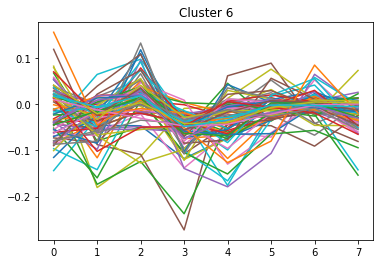

80

In [38]:
a = clusters_data_list3[6]
plt.title('Cluster {}'.format(6))
for c in a['SecurityID']:
    try:
        grpah = new_data[new_data['SecurityID']==c].G_change
        plt.plot(grpah)
    except:
        pass
plt.rcParams["figure.figsize"] = (16,10)
plt.show()
len(a)

for i in range(0,len(clusters_data_list3)):
    plt.figure()
    a = clusters_data_list3[i]
    plt.title('Cluster {}   {} Bonds'.format(i,len(a)))
    for c in a['SecurityID']:
        try:
            graph = new_data[new_data['SecurityID']==c].G_change
            plt.plot(graph)
        except:
            pass
    plt.rcParams["figure.figsize"] = (16,10)
    plt.savefig('/Users/yangli/OneDrive/MMAI/Capstone/Jupyter Notebook/Graph/cluster{}_{}.png'.format(i,'2019-02-28'))

from sklearn.metrics import silhouette_score
inertias = {}
silhouettes = {}
for k in range(2, 200):
    kmeans = KMeans(init='k-means++', n_init=10, n_clusters=k, max_iter=1000, random_state=42).fit(data_scaled)
    inertias[k] = kmeans.inertia_ # Inertia: Sum of distances of samples to their closest cluster center
    silhouettes[k] = silhouette_score(data_scaled, kmeans.labels_, metric='euclidean')
    

plt.figure();
plt.grid(True);
plt.plot(list(inertias.keys()), list(inertias.values()));
plt.title('K-Means, Elbow Method')
plt.xlabel("Number of clusters, K");
plt.ylabel("Inertia");


plt.figure();
plt.grid(True);
plt.plot(list(silhouettes.keys()), list(silhouettes.values()));
plt.title('K-Means, Elbow Method')
plt.xlabel("Number of clusters, K");
plt.ylabel("Silhouette");

In [39]:
clusters_data_list3[0]

,SecurityID,Sector,Industry,Sub_Industry,Seniority,Issuedby,Country,Rating,AmountIssued,Coupon,IssueDate,MaturityDate,Bond_Term,Term_Type,Cupon_Type,Group
0,194.0,Financials,Diversified Banks,Diversified Banking Inst,Sr Unsecured,ROYAL BANK OF SCOTLAND GROUP PLC,GB,Lower medium grade,1.500000e+09,6.400,2009-10-21,2019-10-21,10,Long Term,FIXED,Cluster 0
1,207.0,Financials,Banks,Commer Banks-Southern US,Subordinated Unsecured,SYNOVUS FINANCIAL CORP,US,Junk,2.500000e+08,5.750,2015-12-07,2025-12-15,10,Long Term,VARIABLE,Cluster 0
2,2914.0,Consumers,Food & Beverage,Vitamins&Nutrition Prod,Sr Unsecured,MEAD JOHNSON NUTRITION CO,GB,Upper medium grade,7.000000e+08,4.900,2010-07-06,2019-11-01,9,Mid Term,FIXED,Cluster 0
3,3630.0,Auto,Automobiles Manufacturing,Auto-Cars/Light Trucks,Sr Unsecured,FORD MOTOR CREDIT CO LLC,US,Lower medium grade,1.250000e+09,8.125,2009-12-14,2020-01-15,11,Long Term,FIXED,Cluster 0
4,4478.0,Communications,Entertainment Content,Television,Sr Unsecured,CBS CORP,US,Lower medium grade,7.000000e+08,3.375,2012-03-02,2022-03-01,10,Long Term,FIXED,Cluster 0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,52051.0,Industrials,Transportation & Logistics,Marine Services,Sr Unsecured,MERSIN ULUSLARARASI LIMAN ISLETMECILIGI AS,TR,Junk,4.500000e+08,5.875,2013-08-12,2020-08-12,7,Mid Term,FIXED,Cluster 0
66,52391.0,Financials,Utilities,Electric-Distribution,Secured,NATIONAL RURAL UTILITIES COOPERATIVE FINANCE CORP,US,Upper medium grade,4.000000e+08,2.350,2013-06-06,2020-06-15,7,Mid Term,FIXED,Cluster 0
67,53510.0,Basic Materials,Chemicals,Coatings/Paint,Sr Unsecured,RPM INTERNATIONAL INC,US,Lower medium grade,4.500000e+08,6.125,2009-10-09,2019-10-15,10,Long Term,FIXED,Cluster 0
68,53554.0,Real Estate,Real Estate,Real Estate Mgmnt/Servic,Sr Unsecured,REALOGY GROUP LLC / REALOGY CO-ISSUER CORP,US,Junk,5.500000e+08,5.250,2014-11-21,2021-12-01,7,Mid Term,FIXED,Cluster 0


In [40]:
from sklearn.cluster import AgglomerativeClustering
cluster = AgglomerativeClustering(n_clusters=300, affinity='euclidean', linkage='average')  
cluster2_array = cluster.fit_predict(data_scaled)

In [41]:
clusters2 = create_cluster_list(cluster2_array)
clusters_list2 = grab_clusters(clusters2,fdata.reset_index(),security_data,rating_data)

In [42]:
clusters_data_list2 = transfer_to_list_of_pd(clusters_list2)

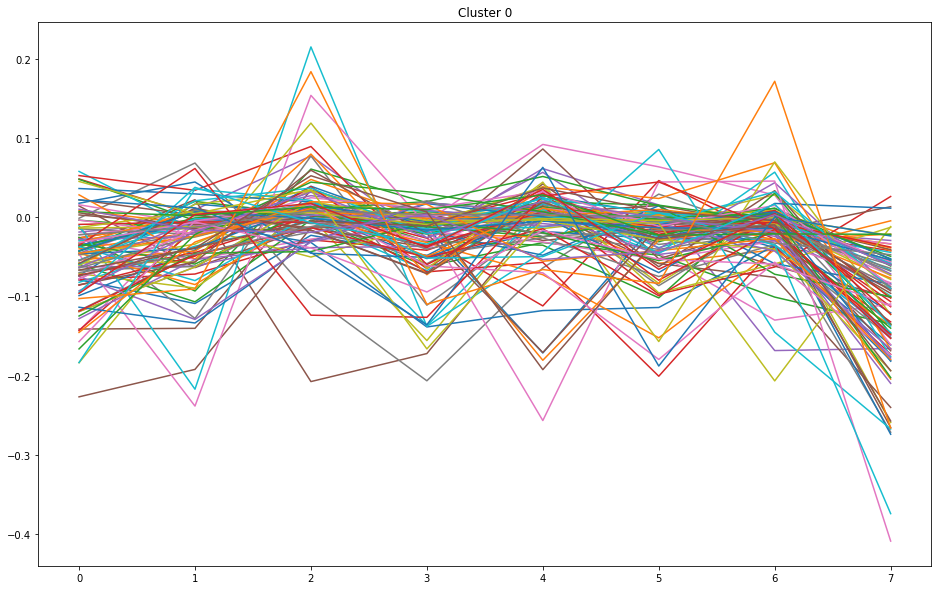

106

In [43]:
a = clusters_data_list2[30]
plt.title('Cluster {}'.format(0))
for c in a['SecurityID']:
    try:
        grpah = new_data[new_data['SecurityID']==c].G_change
        plt.plot(grpah)
    except:
        pass
plt.rcParams["figure.figsize"] = (16,10)
plt.show()
len(a)

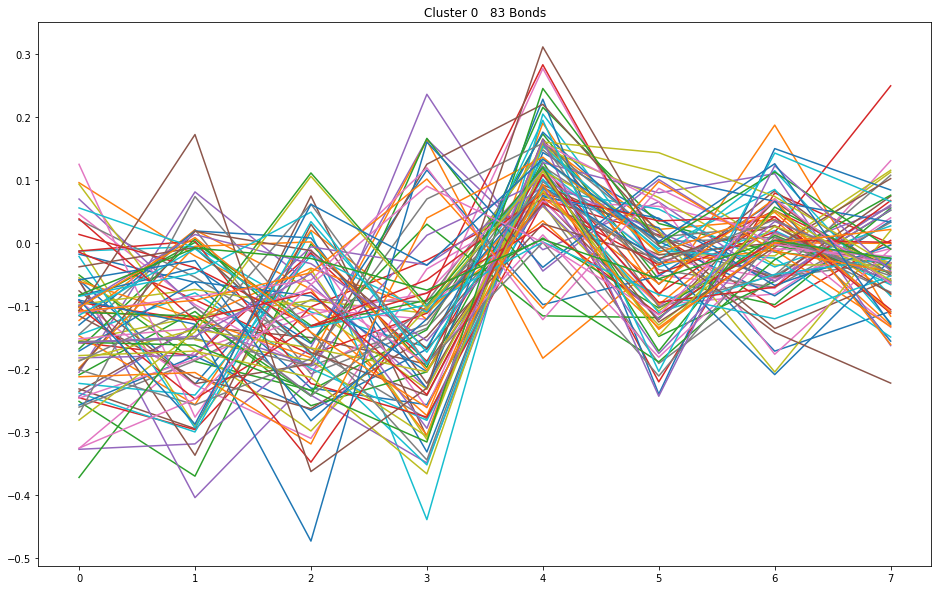

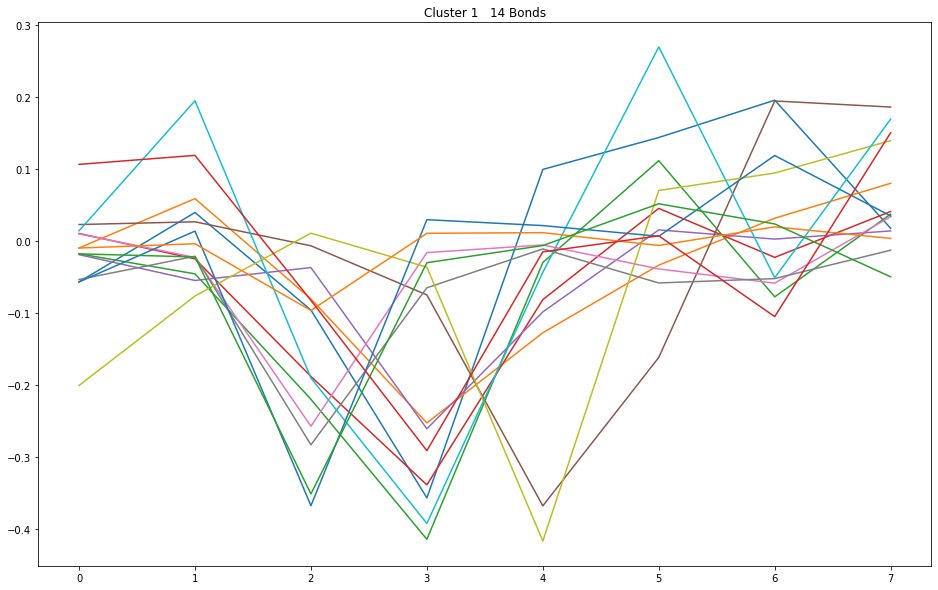

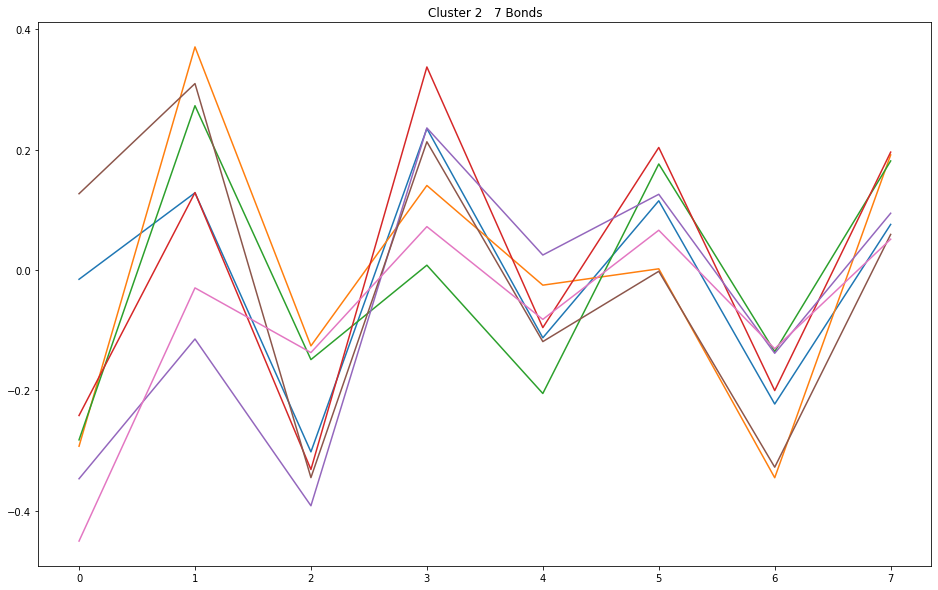

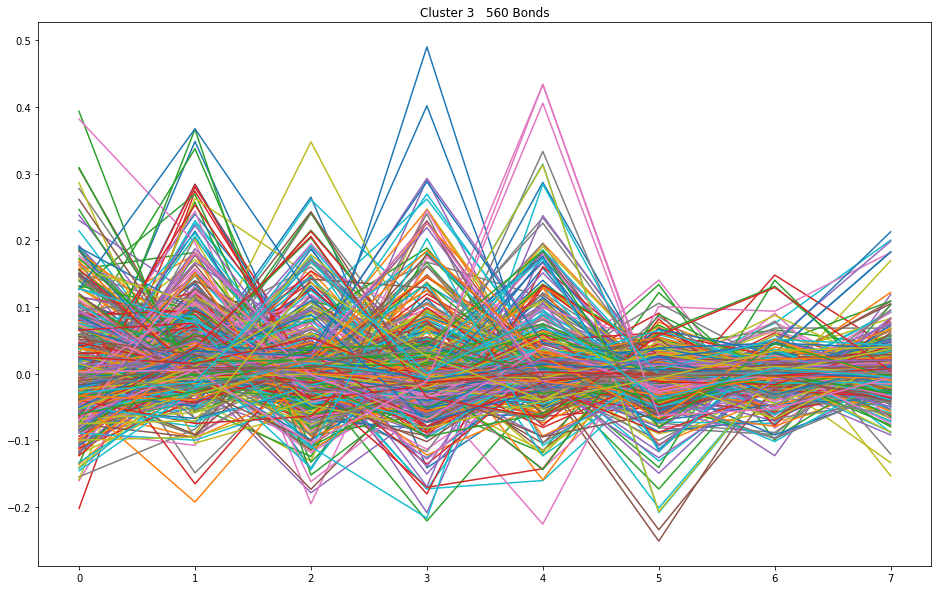

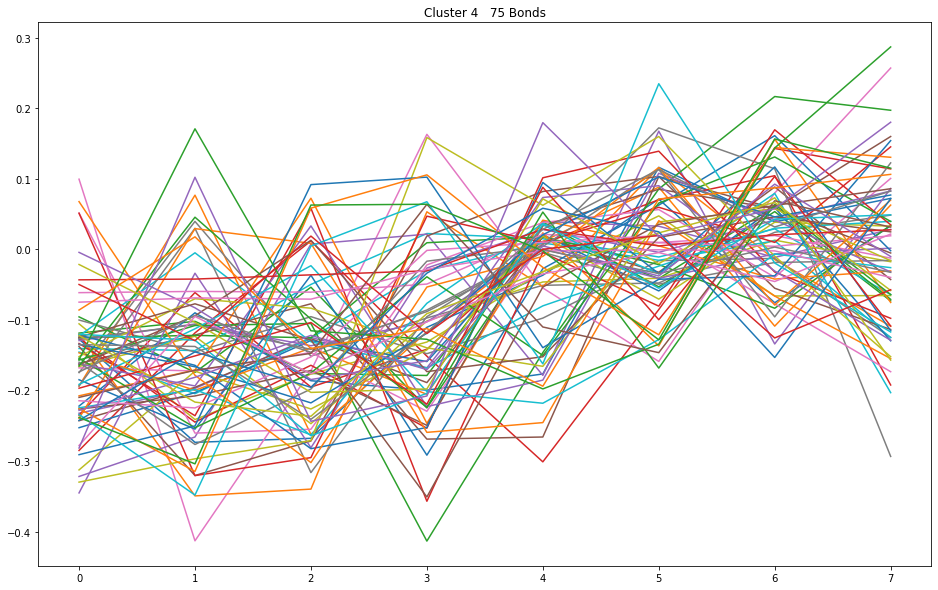

...

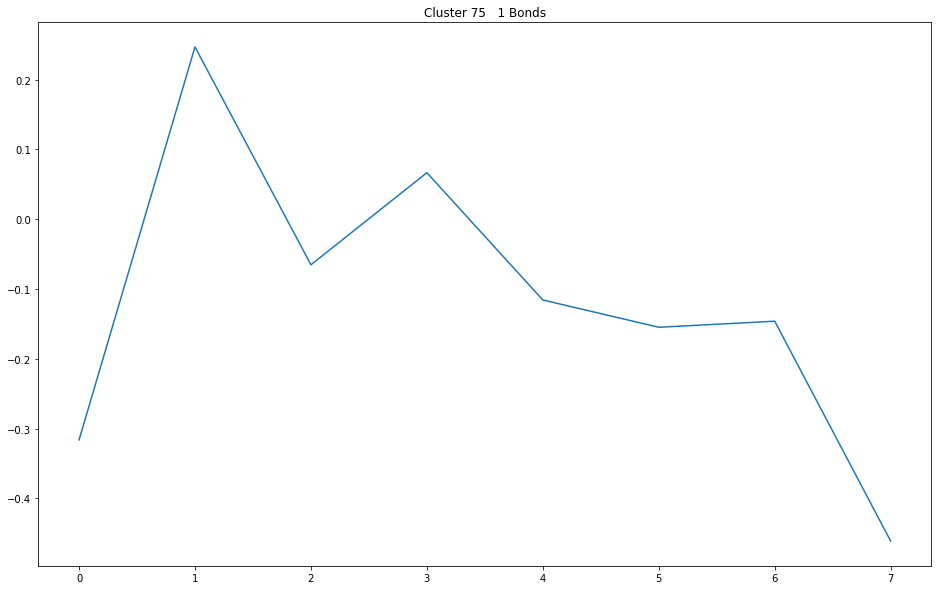

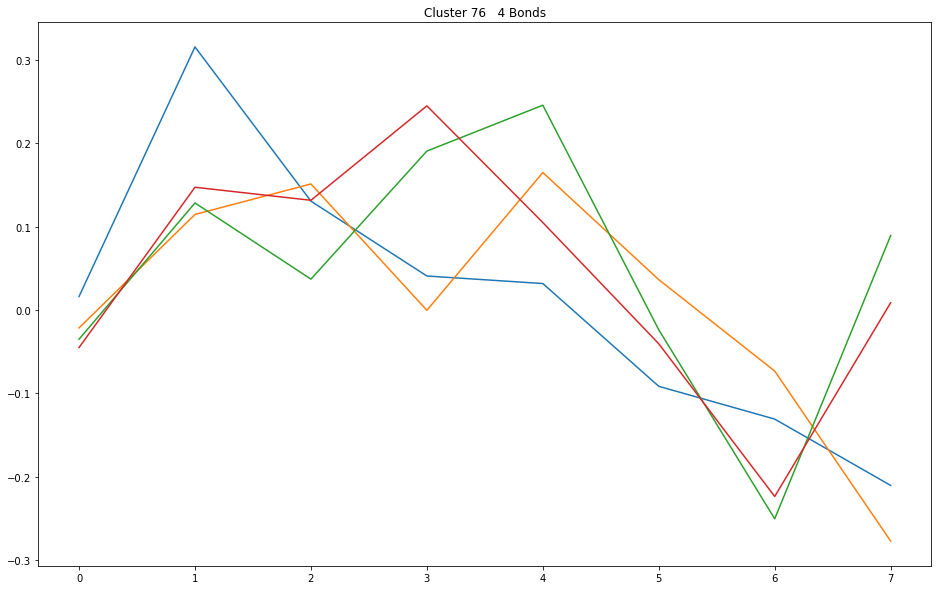

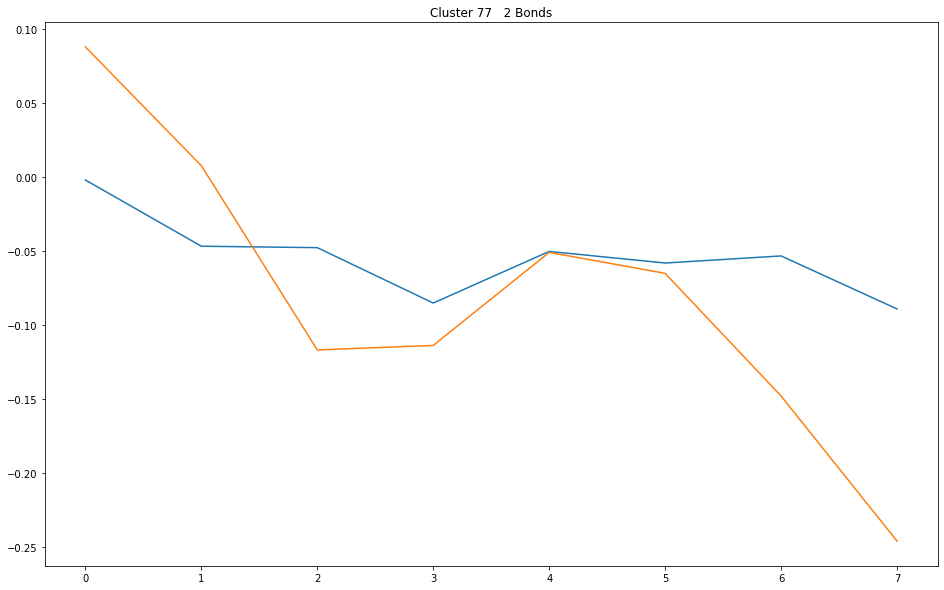

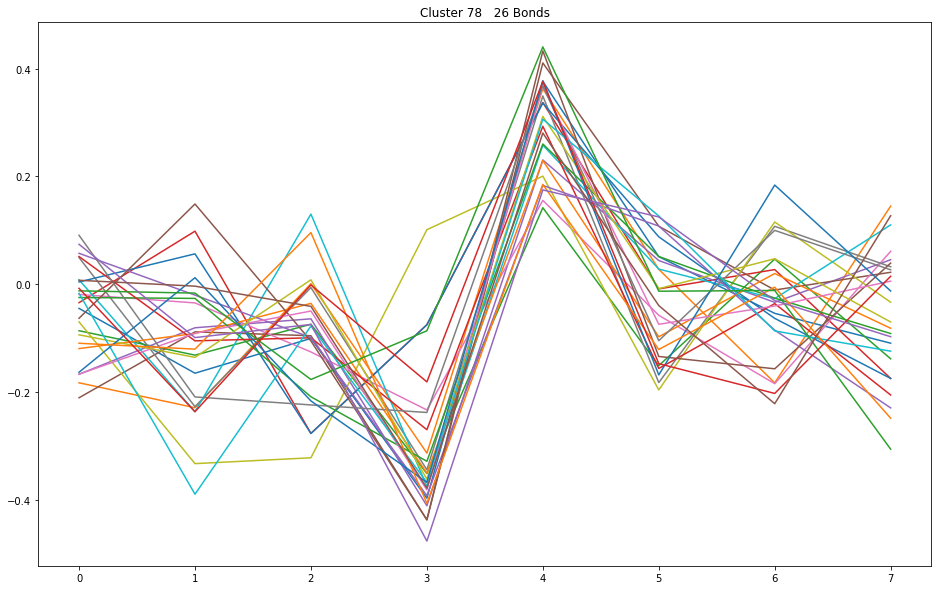

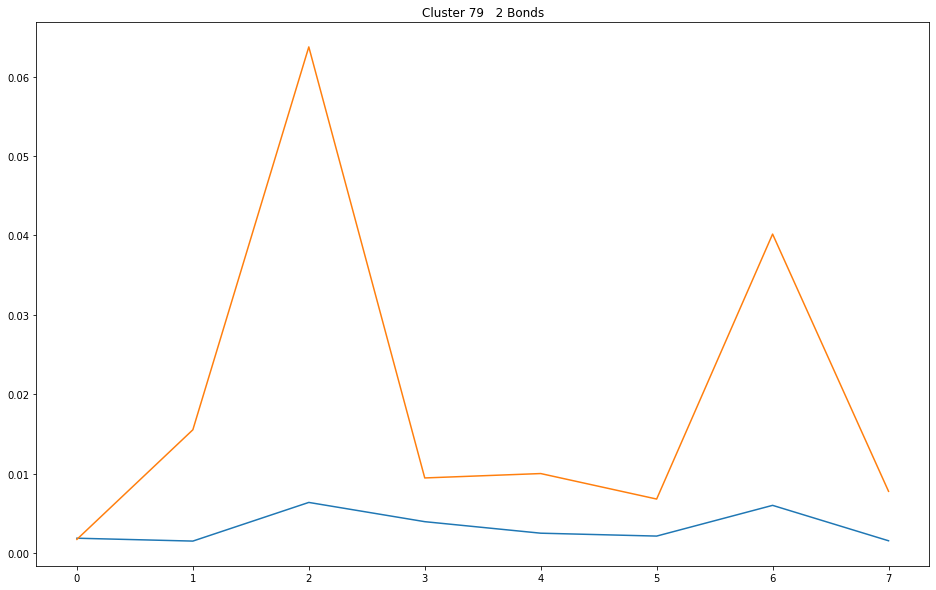

In [114]:
for i in range(0,len(clusters_data_list2)):
    plt.figure()
    a = clusters_data_list2[i]
    plt.title('Cluster {}   {} Bonds'.format(i,len(a)))
    for c in a['SecurityID']:
        try:
            graph = new_data[new_data['SecurityID']==c].G_change
            plt.plot(graph)
        except:
            pass
    plt.rcParams["figure.figsize"] = (16,10)
    plt.savefig('/Users/yangli/OneDrive/MMAI/Capstone/Jupyter Notebook/Graph/cluster{}_{}_{}bonds.png'.format(i,'2019-02-28',len(a)))

## GET the Cluster data through the year

In [51]:
clusters_data_list3[2].head()

NameError: name 'clusters_data_list3' is not defined

In [54]:
a = clusters_data_list3[1].groupby(['Country','Rating','Sector','Seniority','Term_Type']).count()
print(len(clusters_data_list3[1]))
a['SecurityID']['US']['Upper medium grade']

NameError: name 'clusters_data_list3' is not defined

In [57]:
a = clusters_data_list3[0].groupby(['Country','Rating','Sector','Seniority','Term_Type']).count()
print(len(clusters_data_list3[0]))
a['SecurityID']['US']['Upper medium grade']

NameError: name 'clusters_data_list3' is not defined

In [60]:
a = clusters_data_list3[4].groupby(['Country','Rating','Sector','Seniority','Term_Type']).count()
print(len(clusters_data_list3[4]))
a[a['SecurityID']>=0.02]['SecurityID']['US']['Upper medium grade']

NameError: name 'clusters_data_list3' is not defined

In [65]:
a = clusters_data_list3[5].groupby(['Country','Rating','Sector','Seniority','Term_Type']).count()
print(len(clusters_data_list3[5]))
a[a['SecurityID']>=0.02]['SecurityID']['US']['Upper medium grade']

NameError: name 'clusters_data_list3' is not defined

In [ ]:
cluster_info = pd.DataFrame()

In [72]:
d1 = collect_cluster_info(clusters_data_list3[0],'2019-02-28')

NameError: name 'clusters_data_list3' is not defined

In [ ]:
d1